In [1]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob as glob
import itertools
import seaborn as sns
from itertools import chain
from tqdm import tqdm, tqdm_notebook, tnrange
from sklearn.metrics import precision_score, accuracy_score, recall_score, confusion_matrix, ConfusionMatrixDisplay
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.models import Sequential, Model, load_model, save_model
from tensorflow.keras.layers import (Conv2D, MaxPooling2D, Dense, Flatten, Activation, Dropout)
from tensorflow.keras import backend as K

%matplotlib inline

In [2]:
train_data = np.load('/kaggle/input/plant-npy/train_data.npy', allow_pickle=True)
train_labels = np.load('/kaggle/input/plant-npy/train_labels.npy', allow_pickle=True)
val_data = np.load('/kaggle/input/plant-npy/val_data.npy', allow_pickle=True)
val_labels = np.load('/kaggle/input/plant-npy/val_labels.npy', allow_pickle=True)

In [5]:
#data_path = "/kaggle/input/new-plant-diseases-dataset/"
train_path = "/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train"
val_path = "/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid"
test_path = "/kaggle/input/new-plant-diseases-dataset/test/test"
classes = os.listdir(train_path)
classes

['Tomato___Late_blight',
 'Tomato___healthy',
 'Grape___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Potato___healthy',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Tomato___Early_blight',
 'Tomato___Septoria_leaf_spot',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Strawberry___Leaf_scorch',
 'Peach___healthy',
 'Apple___Apple_scab',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Bacterial_spot',
 'Apple___Black_rot',
 'Blueberry___healthy',
 'Cherry_(including_sour)___Powdery_mildew',
 'Peach___Bacterial_spot',
 'Apple___Cedar_apple_rust',
 'Tomato___Target_Spot',
 'Pepper,_bell___healthy',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Potato___Late_blight',
 'Tomato___Tomato_mosaic_virus',
 'Strawberry___healthy',
 'Apple___healthy',
 'Grape___Black_rot',
 'Potato___Early_blight',
 'Cherry_(including_sour)___healthy',
 'Corn_(maize)___Common_rust_',
 'Grape___Esca_(Black_Measles)',
 'Raspberry___healthy'

In [3]:
train_num, val_num = {}, {}

for each in classes:
    train_num[each] = len(os.listdir(os.path.join(train_path, each)))
    val_num[each] = len(os.listdir(os.path.join(val_path, each)))
img_per_class = pd.DataFrame(train_num.values(), train_num.keys(), columns=["Image per Class"])
img_per_class

,Image per Class
Tomato___Late_blight,1851
Tomato___healthy,1926
Grape___healthy,1692
Orange___Haunglongbing_(Citrus_greening),2010
Soybean___healthy,2022
Squash___Powdery_mildew,1736
Potato___healthy,1824
Corn_(maize)___Northern_Leaf_Blight,1908
Tomato___Early_blight,1920
Tomato___Septoria_leaf_spot,1745


<AxesSubplot:title={'center':'Images per Plant in Train DS'}, xlabel='Plants (Classes)', ylabel='No. of images'>

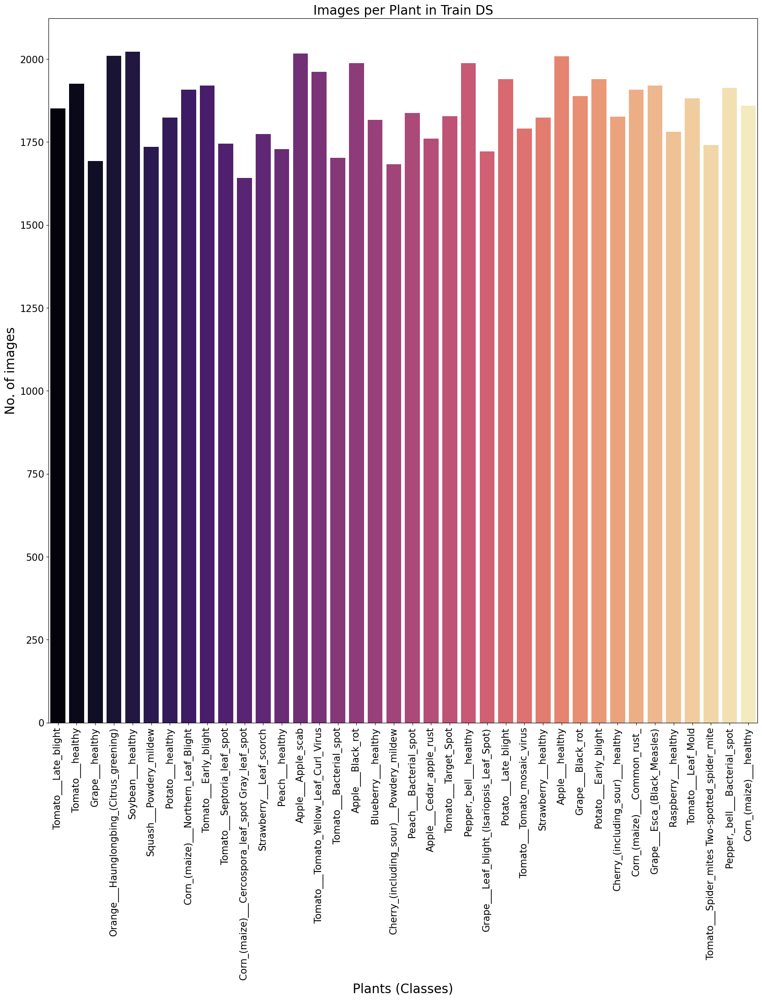

In [4]:
plt.figure(figsize=(20, 20))
plt.xlabel("Plants (Classes)", fontsize=20)
plt.xticks(rotation=90, fontsize=15)
plt.ylabel("No. of images", fontsize=20)
plt.yticks(fontsize=15)
plt.title("Images per Plant in Train DS", fontsize=20)
sns.barplot(x=list(train_num.keys()), y=list(train_num.values()), palette='magma', orient='v')

In [5]:
print(f'All images in validation dataset: {sum(val_num.values())}')

All images in validation dataset: 17572


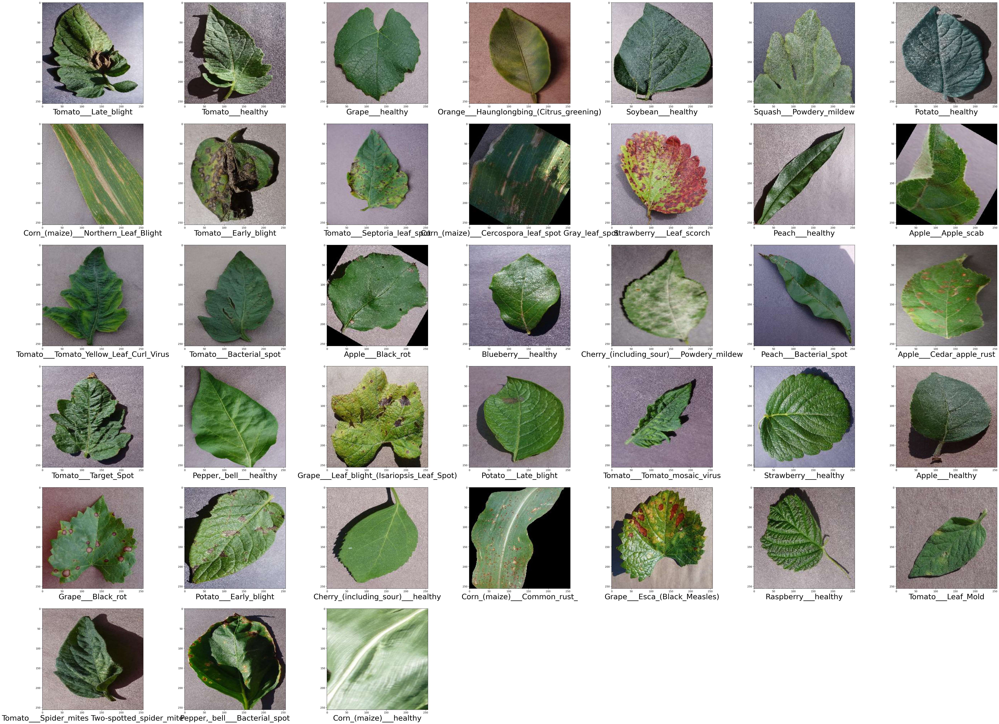

In [6]:
plt.figure(figsize=(70,60))
count = 1
for i in os.listdir(train_path):
    plt.subplot(7,7,count)
    img_path = os.listdir(train_path+"/"+i)
    img_show = plt.imread(train_path+"/"+i+"/"+img_path[0])
    plt.imshow(img_show)
    plt.xlabel(i, fontsize=30)
    count+=1

<AxesSubplot:title={'center':'Image per Plant in Validation DS'}, xlabel='Plants (Classes)', ylabel='No. of Images'>

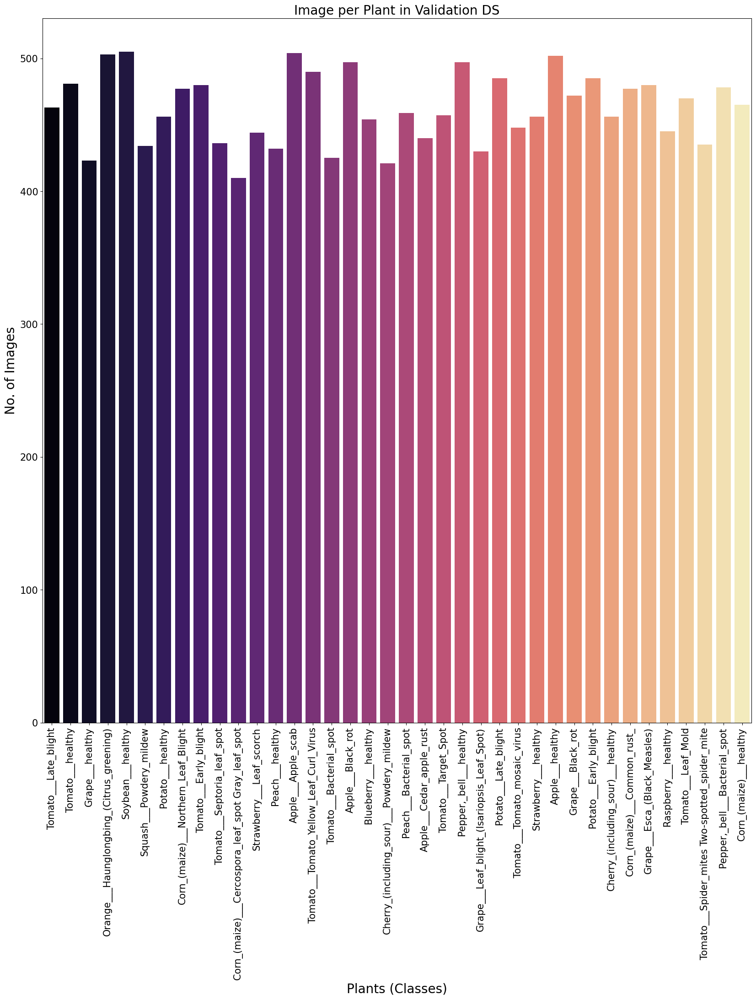

In [7]:
plt.figure(figsize=(20, 20))
plt.xlabel('Plants (Classes)', fontsize=20)
plt.xticks(rotation=90, fontsize=15)
plt.ylabel('No. of Images', fontsize=20)
plt.yticks(fontsize=15)
plt.title('Image per Plant in Validation DS', fontsize=20)
sns.barplot(x=list(val_num.keys()), y=list(val_num.values()), palette='magma', orient='v')

In [8]:
val_img_per_class = pd.DataFrame(val_num.values(), val_num.keys(), columns=['Val images per Class'])
val_img_per_class

,Val images per Class
Tomato___Late_blight,463
Tomato___healthy,481
Grape___healthy,423
Orange___Haunglongbing_(Citrus_greening),503
Soybean___healthy,505
Squash___Powdery_mildew,434
Potato___healthy,456
Corn_(maize)___Northern_Leaf_Blight,477
Tomato___Early_blight,480
Tomato___Septoria_leaf_spot,436


In [9]:
print(f'All images in train dataset: {sum(train_num.values())}')

All images in train dataset: 70295


In [12]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define the train and validation data generators with augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
    width_shift_range=0.2,
    height_shift_range=0.2
)

val_datagen = ImageDataGenerator(
    rescale=1./255,
)


img_size = (256, 256)

# Use the flow_from_directory method to generate the augmented images for the train and validation datasets
train_generator = train_datagen.flow_from_directory(
    train_path,
    target_size=img_size,
    batch_size=32,
    class_mode='categorical',
    shuffle=True
)

train_data, train_labels = train_generator.next()

val_generator = val_datagen.flow_from_directory(
    val_path,
    target_size=img_size,
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

val_data, val_labels = val_generator.next()


# Print the number of classes in the dataset
num_classes = len(train_generator.class_indices)
print("Number of classes: ", num_classes)


Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.
Number of classes:  38


In [ ]:
data = []
labels = []
for i in range(train_generator.samples // train_generator.batch_size):
    batch, label = train_generator.next()
    data.append(batch)
    labels.append(label)

# Concatenate the batches into a single numpy array
data_array = np.concatenate(data)
labels_array = np.concatenate(labels)

In [ ]:
val_data = []
val_labels = []
for i in range(val_generator.samples // val.batch_size):
    batch, label = val_generator.next()
    val_data.append(batch)
    val_labels.append(label)

# Concatenate the batches into a single numpy array
val_data_array = np.concatenate(val_data)
val_labels_array = np.concatenate(val_labels)

In [ ]:
train_data = np.array([train_generator.next()[0] for i in range(train_generator.__len__())])
val_data = np.array([val_generator.next()[0] for i in range(val_generator.__len__())])

In [7]:
pip install tensorflow-model-optimization

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.6/240.6 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.9/238.9 kB 20.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [8]:
import tensorflow_model_optimization as tfmot
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(256, 256, 3)),
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same'),

    tf.keras.layers.Conv2D(512, (5, 5), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(512, (5, 5), activation='relu', padding='same'),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1024, activation='relu'),
    tf.keras.layers.Dropout(.5),

    tf.keras.layers.Dense(38, activation='softmax')
])

lr = 0.0001

model = tfmot.quantization.keras.quantize_model(model)
model.compile(loss='sparse_categorical_crossentropy',optimizer=keras.optimizers.Adam(learning_rate=lr), 
              metrics=["accuracy"])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 quantize_layer (QuantizeLay  (None, 256, 256, 3)      3         
 er)                                                             
                                                                 
 quant_conv2d (QuantizeWrapp  (None, 256, 256, 32)     963       
 erV2)                                                           
                                                                 
 quant_conv2d_1 (QuantizeWra  (None, 256, 256, 32)     9315      
 pperV2)                                                         
                                                                 
 quant_max_pooling2d (Quanti  (None, 85, 85, 32)       1         
 zeWrapperV2)                                                    
                                                                 
 quant_conv2d_2 (QuantizeWra  (None, 85, 85, 64)       1

In [13]:
# Define the CNN model
model2 = Sequential()

model2.add(Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(64, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(128, (3, 3), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Flatten())

model2.add(Dense(256, activation='relu'))
model2.add(Dropout(0.5))

model2.add(Dense(38, activation='softmax'))

# Compile the model
model2 = tfmot.quantization.keras.quantize_model(model2)
model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print the model summary
model2.summary()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 quantize_layer_2 (QuantizeL  (None, 256, 256, 3)      3         
 ayer)                                                           
                                                                 
 quant_conv2d_13 (QuantizeWr  (None, 254, 254, 32)     963       
 apperV2)                                                        
                                                                 
 quant_max_pooling2d_6 (Quan  (None, 127, 127, 32)     1         
 tizeWrapperV2)                                                  
                                                                 
 quant_conv2d_14 (QuantizeWr  (None, 125, 125, 64)     18627     
 apperV2)                                                        
                                                                 
 quant_max_pooling2d_7 (Quan  (None, 62, 62, 64)      

In [22]:
history = model.fit(train_data, train_labels, validation_data=(val_data, val_labels), epochs=20, verbose=1)

Epoch 1/20


TypeError: 'NoneType' object is not callable

In [21]:
# Set the CUDA device to use
gpu_device = 0

# Create a TensorFlow session with the selected GPU device
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
config.gpu_options.visible_device_list = str(gpu_device)
sess = tf.compat.v1.Session(config=config)

# Train the model with GPU acceleration
with tf.device('/device:GPU:{}'.format(gpu_device)):
    history2 = model2.fit(train_data, train_labels, epochs=20, validation_data=(val_data, val_labels), verbose=1)

Epoch 1/20
1/1 [==============================] - 0s 314ms/step - loss: 0.0236 - accuracy: 1.0000 - val_loss: 3.9576 - val_accuracy: 0.0625
Epoch 2/20
1/1 [==============================] - 0s 174ms/step - loss: 0.0305 - accuracy: 1.0000 - val_loss: 3.8966 - val_accuracy: 0.0938
Epoch 3/20
1/1 [==============================] - 0s 163ms/step - loss: 0.0483 - accuracy: 1.0000 - val_loss: 3.7998 - val_accuracy: 0.1250
Epoch 4/20
1/1 [==============================] - 0s 131ms/step - loss: 0.0263 - accuracy: 1.0000 - val_loss: 3.7762 - val_accuracy: 0.1250
Epoch 5/20
1/1 [==============================] - 0s 171ms/step - loss: 0.0193 - accuracy: 1.0000 - val_loss: 3.8025 - val_accuracy: 0.1250
Epoch 6/20
1/1 [==============================] - 0s 135ms/step - loss: 0.0201 - accuracy: 1.0000 - val_loss: 3.8093 - val_accuracy: 0.0938
Epoch 7/20
1/1 [==============================] - 0s 172ms/step - loss: 0.0689 - accuracy: 0.9688 - val_loss: 3.7732 - val_accuracy: 0.1250
Epoch 8/20
1/1 [====

In [25]:
model2.save('plant_cnn_model_optimized.h5')

In [ ]:
plt.figure(figsize = (20,5))
plt.subplot(1,2,1)
plt.title("Train and Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.plot(history.history['loss'],label="Train Loss")
plt.plot(history.history['val_loss'], label="Validation Loss")
plt.xlim(0, 10)
plt.ylim(0.0,1.0)
plt.legend()

plt.subplot(1,2,2)
plt.title("Train and Validation Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.plot(history.history['accuracy'], label="Train Accuracy")
plt.plot(history.history['val_accuracy'], label="Validation Accuracy")
plt.xlim(0, 9.25)
plt.ylim(0.75,1.0)
plt.legend()
plt.tight_layout()

In [14]:
labels = []
predictions = []
for x,y in val_gen:
    labels.append(list(y.numpy()))
    predictions.append(tf.argmax(model2.predict(x),1).numpy())

1/1 [==============================] - 0s 124ms/step


In [ ]:
plt.figure(figsize= (20,5))
cm = confusion_matrix(labels, predictions)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=list(range(1,39)))
fig, ax = plt.subplots(figsize=(12,12))
disp.plot(ax=ax,colorbar= False,cmap = 'YlGnBu')
plt.title("Confusion Matrix")
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [15]:
predictions = list(itertools.chain.from_iterable(predictions))
labels = list(itertools.chain.from_iterable(labels))

In [16]:
print("Train Accuracy  : {:.2f} %".format(history.history['accuracy'][-1]*100))
print("Test Accuracy   : {:.2f} %".format(accuracy_score(labels, predictions) * 100))
print("Precision Score : {:.2f} %".format(precision_score(labels, predictions, average='micro') * 100))
print("Recall Score    : {:.2f} %".format(recall_score(labels, predictions, average='micro') * 100))

Train Accuracy  : 99.20 %
Test Accuracy   : 97.14 %
Precision Score : 97.14 %
Recall Score    : 97.14 %


In [16]:
Li = ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 
      'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 
      'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 
      'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 
      'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 
      'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch',
      'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 
      'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite',
      'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']

# predicting an image
import os
import matplotlib.pyplot as plt
from keras.preprocessing import image
import numpy as np
files = [os.path.join(test_path,p) for p in sorted(os.listdir(test_path))]
for i in range(0,10):
    image_path = files[i]
    new_img =keras.utils.load_img(image_path, target_size=(256, 256))
    img = keras.utils.img_to_array(new_img)
    img = np.expand_dims(img, axis=0)
    img = img/255
    prediction = model2.predict(img)
    probabilty = prediction.flatten()
    max_prob = probabilty.max()
    index=prediction.argmax(axis=-1)[0]
    class_name = Li[index]
    print(class_name)
    #ploting image with predicted class name        
    #plt.figure(figsize = (4,4))
    #plt.imshow(new_img)
    #plt.axis('off')
    #plt.title(class_name+" "+ str(max_prob)[0:4]+"%")
    #plt.show()

1/1 [==============================] - 0s 25ms/step
Apple___Cedar_apple_rust
1/1 [==============================] - 0s 24ms/step
Apple___Cedar_apple_rust
1/1 [==============================] - 0s 25ms/step
Apple___Cedar_apple_rust
1/1 [==============================] - 0s 26ms/step
Apple___Cedar_apple_rust
1/1 [==============================] - 0s 29ms/step
Apple___Apple_scab
1/1 [==============================] - 0s 28ms/step
Tomato___Leaf_Mold
1/1 [==============================] - 0s 25ms/step
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
1/1 [==============================] - 0s 30ms/step
Corn_(maize)___Common_rust_
1/1 [==============================] - 0s 28ms/step
Corn_(maize)___Common_rust_
1/1 [==============================] - 0s 28ms/step
Corn_(maize)___Common_rust_


In [26]:
def get_file_size(file_path):
    size = os.path.getsize(file_path)
    return size

def convert_bytes(size, unit=None):
    if unit == "KB":
        return print('File size: ' + str(round(size / 1024, 3)) + ' Kilobytes')
    elif unit == "MB":
        return print('File size: ' + str(round(size / (1024 * 1024), 3)) + ' Megabytes')
    else:
        return print('File size: ' + str(size) + ' bytes')

TF_LITE_MODEL_FILE_NAME = "plant_cnn_model2.tflite"
tf_lite_converter = tf.lite.TFLiteConverter.from_keras_model(model2)
tflite_model = tf_lite_converter.convert()

tflite_model_name = TF_LITE_MODEL_FILE_NAME
open(tflite_model_name, "wb").write(tflite_model)

convert_bytes(get_file_size(TF_LITE_MODEL_FILE_NAME), "KB")

File size: 209034.93 Kilobytes


In [21]:
import tensorflowjs as tfjs
tfjs.converters.save_keras_model(model2, 'plant_cnn_model_tfjs')

In [23]:
import shutil
shutil.make_archive("/kaggle/working/plant_cnn_model_tfjs", 'zip', '/kaggle/working/')

'/kaggle/working/plant_cnn_model_tfjs.zip'

In [ ]:
#model.save('my_model.h5')

In [31]:
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_keras_model(model2)
converter.optimizations = [tf.lite.Optimize.DEFAULT]

converter.target_spec.supported_types = [tf.float16]

tf_model = converter.convert()
tf_file = 'optimzed_model.tflite'

with open(tf_file, 'wb') as f:
    f.write(tf_model)